# HELIOS Demo
This notebook demonstrates the basic usage of the HELIOS simulation package.

The demo follows the optical path of a simulation:
1. **Scene observation** - Define astronomical objects and their spectral energy distributions
2. **Telescope pupil & Interferometry** - Configure aperture geometry and baseline arrays
3. **Atmospheric effects** - Visualize and control atmospheric phase screens
4. **Coronagraphic masks** - Apply phase masks for high-contrast imaging

## 1. Scene Observation
We start by creating a scene with a star and a planet. The distance to the system is defined at the Scene level.

### Scene Geometry
Visualize the spatial distribution of objects in the scene.

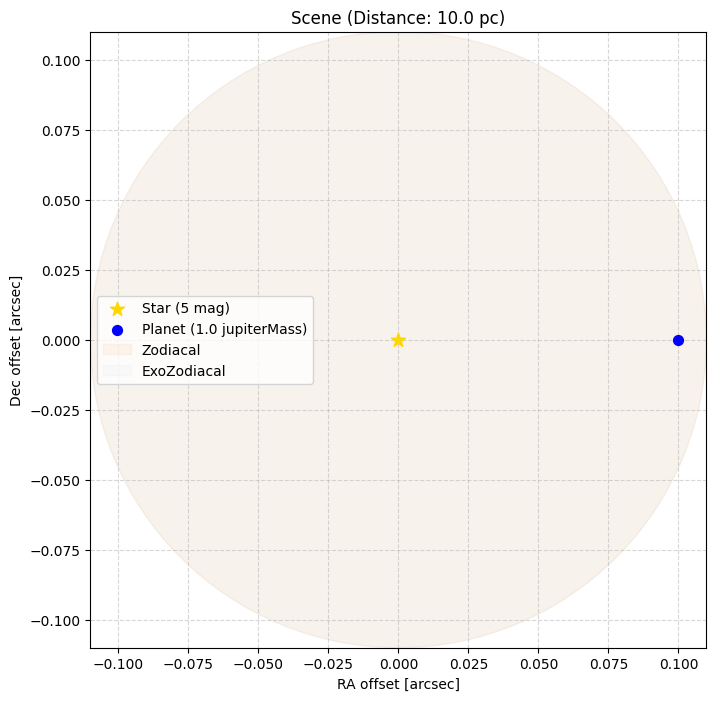

In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt

scene = helios.Scene(distance=10*u.pc)
star = helios.Star(temperature=5700*u.K, magnitude=5, mass=1*u.M_sun, position=(0*u.AU, 0*u.AU))
planet = helios.Planet(mass=1*u.M_jup, position=(1*u.AU, 0*u.AU))
zodi = helios.Zodiacal(brightness=0.5)
exozodi = helios.ExoZodiacal(brightness=0.3)
scene.add(star)
scene.add(planet)
scene.add(zodi)
scene.add(exozodi)

scene.plot()
plt.show()


### Spectral Energy Distributions (SEDs)
Plot the spectral energy distributions of the star and planet to understand their emission characteristics.

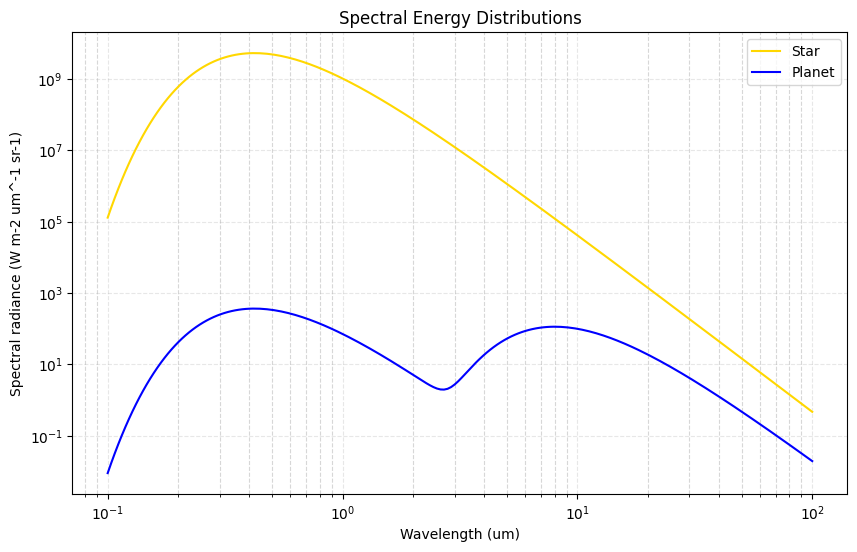

In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt

# Create scene objects if not already defined
if 'star' not in dir():
    star = helios.Star(temperature=5700*u.K, magnitude=5, mass=1*u.M_sun, position=(0*u.AU, 0*u.AU))
    planet = helios.Planet(mass=1*u.M_jup, position=(1*u.AU, 0*u.AU))
    zodi = helios.Zodiacal(brightness=0.5)
    exozodi = helios.ExoZodiacal(brightness=0.3)

# Plot SEDs for star and planet
fig, ax = plt.subplots(figsize=(10, 6))
ax = star.plot_sed(ax=ax, color='gold', label='Star')
ax = planet.plot_sed(ax=ax, color='blue', label='Planet')
ax.set_title('Spectral Energy Distributions')
ax.legend()
ax.grid(True, alpha=0.3)
plt.show()


## 2. Telescope Pupil & Interferometry
The telescope pupil defines the aperture geometry that collects light. HELIOS provides tools to construct custom pupils or use presets.

### Pupil Construction

You can build pupils manually with geometric primitives (disks, spiders, segments) or load telescope presets (JWST, VLT, ELT).

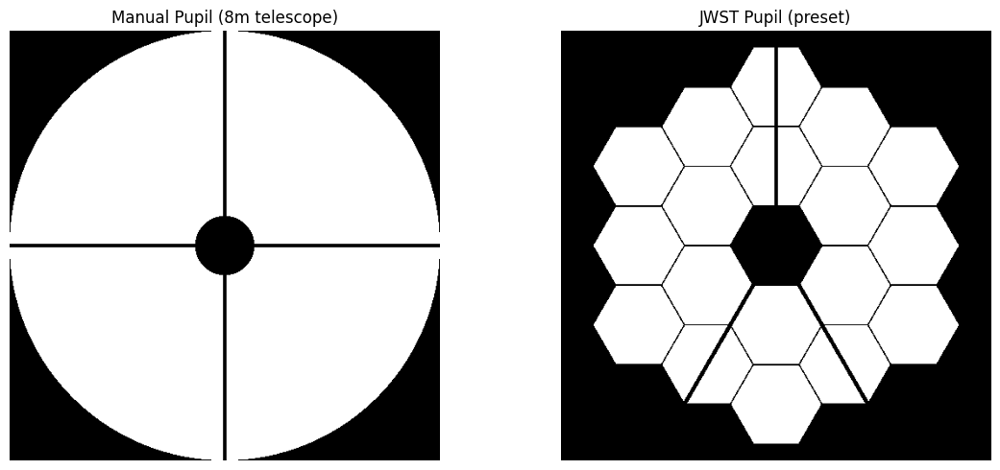

Manual pupil shape: (512, 512), fill factor: 0.757


In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt
import numpy as np

# Manual pupil: simple 8-m class pupil with 4 spiders and central obscuration
p_manual = helios.Pupil(8*u.m)
p_manual.add_disk(radius=4.0 * u.m)
p_manual.add_central_obscuration(diameter=1.1 * u.m)
p_manual.add_spiders(arms=4, width=0.05 * u.m)

# Visualize the pupil
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
arr_manual = p_manual.get_array(npix=512)
axes[0].imshow(arr_manual, origin='lower', cmap='gray')
axes[0].set_title('Manual Pupil (8m telescope)')
axes[0].axis('off')

# JWST preset
p_jwst = helios.Pupil.like('JWST')
arr_jwst = p_jwst.get_array(npix=512)
axes[1].imshow(arr_jwst, origin='lower', cmap='gray')
axes[1].set_title('JWST Pupil (preset)')
axes[1].axis('off')

plt.tight_layout()
plt.show()
print(f"Manual pupil shape: {arr_manual.shape}, fill factor: {arr_manual.mean():.3f}")


### Diffraction Pattern
The pupil geometry determines the point spread function (PSF) via Fourier optics.

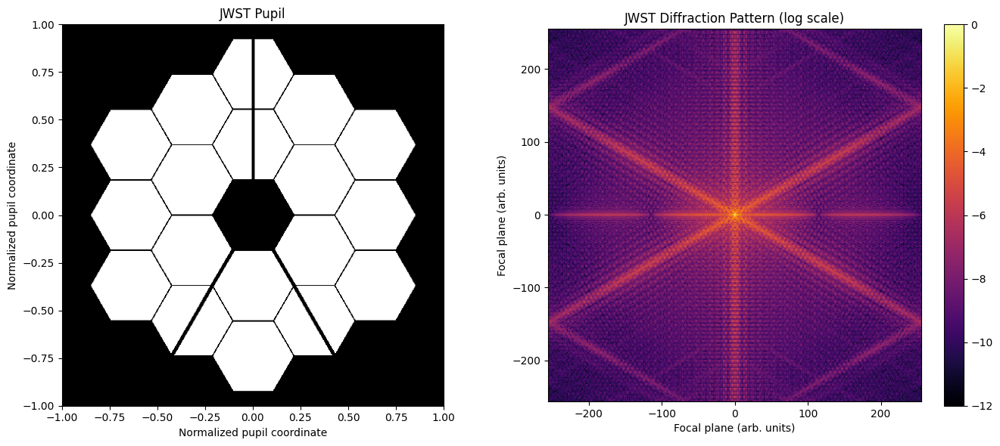

In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt

# Create JWST pupil if not already defined
if 'p_jwst' not in dir():
    p_jwst = helios.Pupil.like('JWST')
    arr_jwst = p_jwst.get_array(npix=512)

# Compute and display diffraction pattern for JWST pupil
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Pupil amplitude
axes[0].imshow(arr_jwst, origin='lower', cmap='gray', extent=[-1, 1, -1, 1])
axes[0].set_title('JWST Pupil')
axes[0].set_xlabel('Normalized pupil coordinate')
axes[0].set_ylabel('Normalized pupil coordinate')

# Diffraction pattern (PSF)
axes[1] = p_jwst.plot_diffraction_pattern(npix=512, log=True, cmap='inferno', 
                                          wavelength=550e-9, ax=axes[1])
axes[1].set_title('JWST Diffraction Pattern (log scale)')

plt.tight_layout()
plt.show()


### Interferometer Configuration
An interferometer combines light from multiple spatially separated collectors. This creates a dilute aperture array with baselines defined by the separation between telescopes.

Interferometer created: VLTI-UTs
Number of collectors: 4
Baselines (m):
[[-16.14  62.74]
 [  0.     0.  ]
 [ 63.03  53.37]
 [101.99  34.54]]


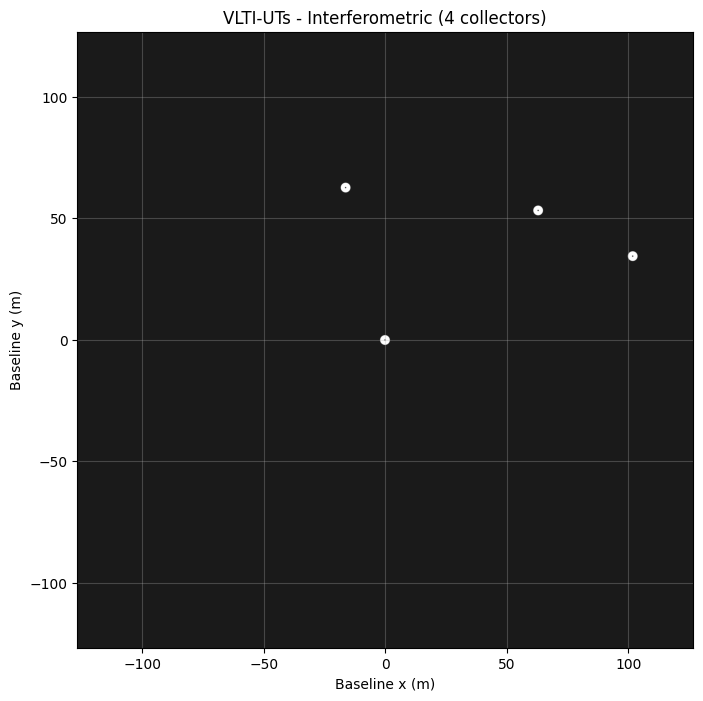

In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt

# Create VLTI interferometer using the preset configuration
vlti = helios.TelescopeArray.vlti(uts=True)

print(f"Interferometer created: {vlti.name}")
print(f"Number of collectors: {len(vlti.collectors)}")
print(f"Baselines (m):\n{vlti.get_baseline_array()}")

# Plot the array configuration
vlti.plot_array(show_pupils=True, pupil_scale=0.5)
plt.show()


### LIFE Space Interferometer
LIFE (Large Interferometer For Exoplanets) is a proposed space-based nulling interferometer for direct exoplanet detection. Since it operates in space at the North Pole configuration (latitude=90°), the array rotates perfectly with Earth's rotation, providing continuous observation geometry without atmospheric turbulence.

Interferometer created: LIFE
Location (space): 90.0 deg, 0.0 deg
Number of collectors: 4
Baselines (m):
[[ -50. -300.]
 [  50. -300.]
 [ -50.  300.]
 [  50.  300.]]
Maximum baseline: 608.28 m


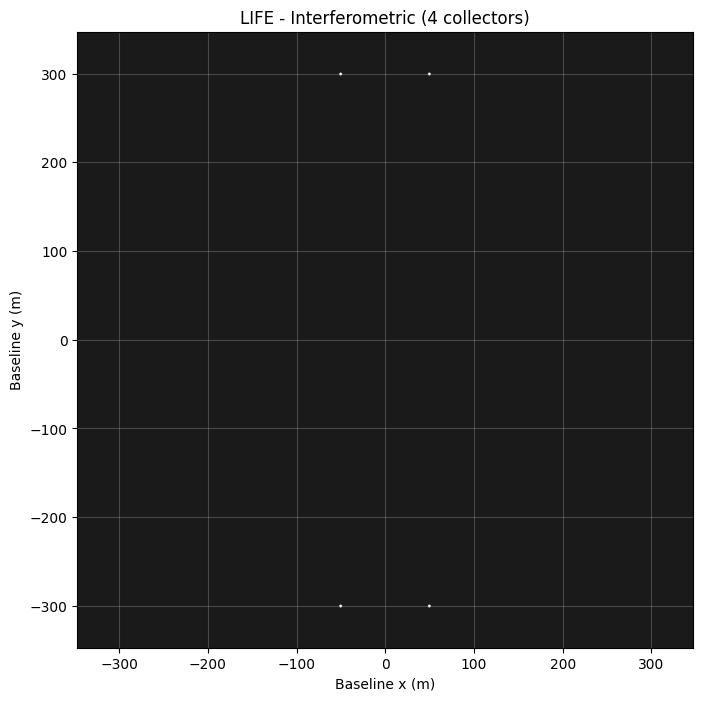

In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt
import numpy as np

# Create LIFE space interferometer using the preset configuration
life = helios.TelescopeArray.life()

print(f"Interferometer created: {life.name}")
print(f"Location (space): {life.latitude}, {life.longitude}")
print(f"Number of collectors: {len(life.collectors)}")
print(f"Baselines (m):\n{life.get_baseline_array()}")

# Calculate maximum baseline
baselines = life.get_baseline_array()
max_bl = max([np.linalg.norm(baselines[i] - baselines[j]) 
              for i in range(len(baselines)) 
              for j in range(i+1, len(baselines))])
print(f"Maximum baseline: {max_bl:.2f} m")

# Plot the array configuration
life.plot_array(show_pupils=True, pupil_scale=0.1)
plt.show()


## 3. Atmospheric Phase Screen (Chromatic Aberrations)
The atmosphere introduces turbulent optical path difference (OPD) errors that are **chromatic** - the phase shift depends on wavelength: φ = 2π × OPD / λ.

This means shorter wavelengths (blue) experience larger phase aberrations than longer wavelengths (infrared) for the same atmospheric turbulence.

Temporal evolution is modeled via **frozen-flow turbulence** (Taylor hypothesis): turbulent screens drift at constant wind velocity.

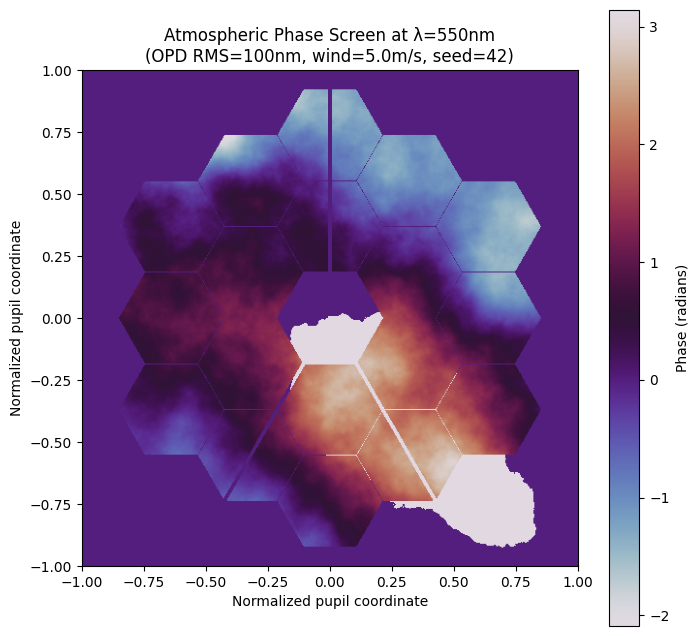

Phase RMS: 1.069 rad
Expected (2π×OPD/λ): 1.142 rad
Wind velocity: [5. 0.] m/s


In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt
import numpy as np

# Create atmosphere with OPD in nanometers (NOT phase in radians!)
# Good seeing: 100nm RMS OPD, 5 m/s wind speed
seed = 42
atm = helios.Atmosphere(rms=100*u.nm, wind_speed=5*u.m/u.s, seed=seed)

# Generate a test wavefront to visualize the phase screen
wavelength = 550e-9 * u.m
N = 512
pupil_test = helios.Pupil.like('JWST')
p_amp = pupil_test.get_array(npix=N, soft=True)

# Create wavefront and apply atmosphere
wf = helios.Wavefront(wavelength=wavelength, size=N)
wf.field = p_amp.astype(np.complex128)
wf_atm = atm.process(wf, None)

# Extract and visualize the phase
phase = np.angle(wf_atm.field)

fig, ax = plt.subplots(figsize=(8, 8))
im = ax.imshow(phase, origin='lower', cmap='twilight', extent=[-1, 1, -1, 1])
ax.set_title(f'Atmospheric Phase Screen at λ={wavelength.to(u.nm).value:.0f}nm\n(OPD RMS={atm.rms*1e9:.0f}nm, wind={np.linalg.norm(atm.wind_velocity):.1f}m/s, seed={seed})')
ax.set_xlabel('Normalized pupil coordinate')
ax.set_ylabel('Normalized pupil coordinate')
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('Phase (radians)')
plt.show()

# Calculate phase RMS and verify chromaticity
phase_rms = np.std(phase[p_amp > 0.1])
expected_phase_rms = 2 * np.pi * atm.rms / wavelength.to(u.m).value
print(f"Phase RMS: {phase_rms:.3f} rad")
print(f"Expected (2π×OPD/λ): {expected_phase_rms:.3f} rad")
print(f"Wind velocity: {atm.wind_velocity} m/s")


### Temporal Evolution of Atmospheric Phase (Frozen-Flow Turbulence)
Simulate frozen-flow turbulence evolution: the turbulent screen drifts at constant wind velocity.
Different observation times sample different regions of the frozen turbulent volume. The SAME seed produces the same frozen turbulence, but different times show different "views" as the wind shifts the pattern.

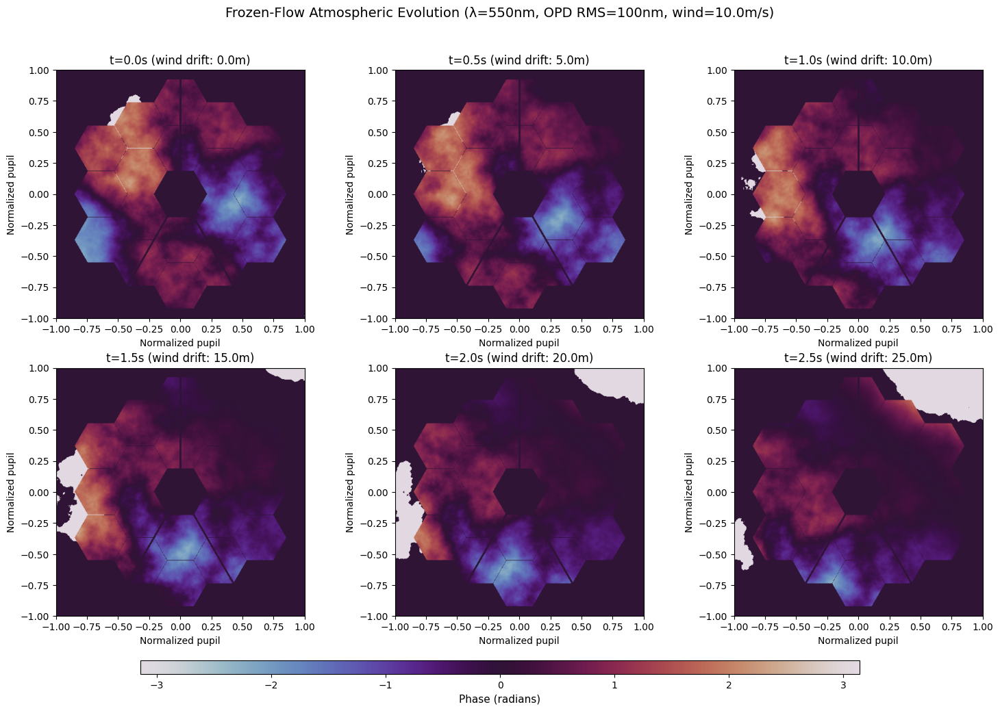

Same turbulent realization (seed=123), different times


In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt
import numpy as np

# Frozen-flow temporal evolution with SAME atmospheric realization (same seed)
# but different observation times

# Mock context class to pass time information
class ObservationContext:
    def __init__(self, time):
        self.time = time

# Create atmosphere with fixed seed and wind
atm_flow = helios.Atmosphere(rms=100*u.nm, wind_speed=10*u.m/u.s, wind_direction=45, seed=123)

# Setup for visualization
wavelength = 550e-9 * u.m
N = 512
pupil_test = helios.Pupil.like('JWST')
p_amp = pupil_test.get_array(npix=N, soft=True)

# Observation times (wind shifts the screen)
times = [0, 0.5, 1.0, 1.5, 2.0, 2.5]  # seconds

fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

for i, t in enumerate(times):
    # Create wavefront
    wf_t = helios.Wavefront(wavelength=wavelength, size=N)
    wf_t.field = p_amp.astype(np.complex128)
    
    # Apply atmosphere at time t
    ctx = ObservationContext(t*u.s)
    wf_t_atm = atm_flow.process(wf_t, ctx)
    
    # Extract phase
    phase_t = np.angle(wf_t_atm.field)
    
    # Plot
    im = axes[i].imshow(phase_t, origin='lower', cmap='twilight', 
                        vmin=-np.pi, vmax=np.pi, extent=[-1, 1, -1, 1])
    axes[i].set_title(f't={t:.1f}s (wind drift: {np.linalg.norm(atm_flow.wind_velocity)*t:.1f}m)')
    axes[i].set_xlabel('Normalized pupil')
    axes[i].set_ylabel('Normalized pupil')

# Add title before tight_layout
plt.suptitle(f'Frozen-Flow Atmospheric Evolution (λ={wavelength.to(u.nm).value:.0f}nm, OPD RMS={atm_flow.rms*1e9:.0f}nm, wind={np.linalg.norm(atm_flow.wind_velocity):.1f}m/s)', 
             fontsize=14, y=0.995)

# Adjust layout to make room for colorbar
plt.tight_layout(rect=[0, 0.05, 1, 0.97])

# Add shared colorbar at bottom
cbar_ax = fig.add_axes([0.15, 0.02, 0.7, 0.02])  # [left, bottom, width, height]
cbar = fig.colorbar(im, cax=cbar_ax, orientation='horizontal')
cbar.set_label('Phase (radians)', fontsize=11)

plt.show()

print(f"Same turbulent realization (seed={atm_flow.seed}), different times")


### Atmospheric Animation with Collectors Overlay
Visualize the frozen-flow evolution of the turbulent phase screen with telescope aperture overlays.

helios.components.atmosphere loaded from: D:\HELIOS\src\helios\components\atmosphere.py


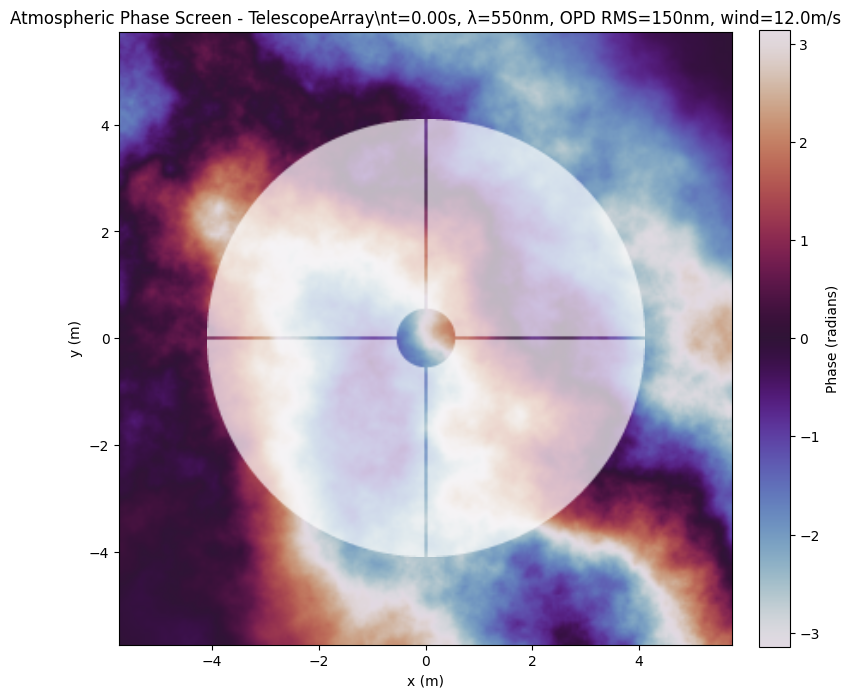

In [ ]:
import sys
import os

# Clear all helios modules from cache
modules_to_clear = [k for k in sys.modules.keys() if k.startswith('helios')]
for mod in modules_to_clear:
    del sys.modules[mod]

# Set path to source
sys.path.insert(0, os.path.abspath('./src'))

# Now import fresh
import helios
from astropy import units as u
from IPython.display import HTML

# Verify we're using the source version
print(f"helios.components.atmosphere loaded from: {helios.components.atmosphere.__file__}")

# Create a single-telescope configuration with a pupil
pupil_vlt = helios.Pupil.like('VLT')
collectors_vlt = helios.TelescopeArray(latitude=-24.6*u.deg, altitude=2635*u.m)
collectors_vlt.add_collector(pupil=pupil_vlt, position=(0, 0), size=8.2*u.m)

# Create animation (shorter duration for demo)
atm_anim = helios.Atmosphere(rms=150*u.nm, wind_speed=12*u.m/u.s, wind_direction=30, seed=456)
anim_single = atm_anim.plot_animation(
    collectors=collectors_vlt, 
    duration=2*u.s,
    wavelength=550e-9*u.m,
    npix=256,
    fps=10,
    figsize=(8, 8)
)

# Display the animation
HTML(anim_single.to_jshtml())

### Atmospheric Animation with Interferometer
Visualize how the atmospheric turbulence affects an interferometric array. The animation shows the phase screen drifting across all four telescopes.

Animation size has reached 20990556 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


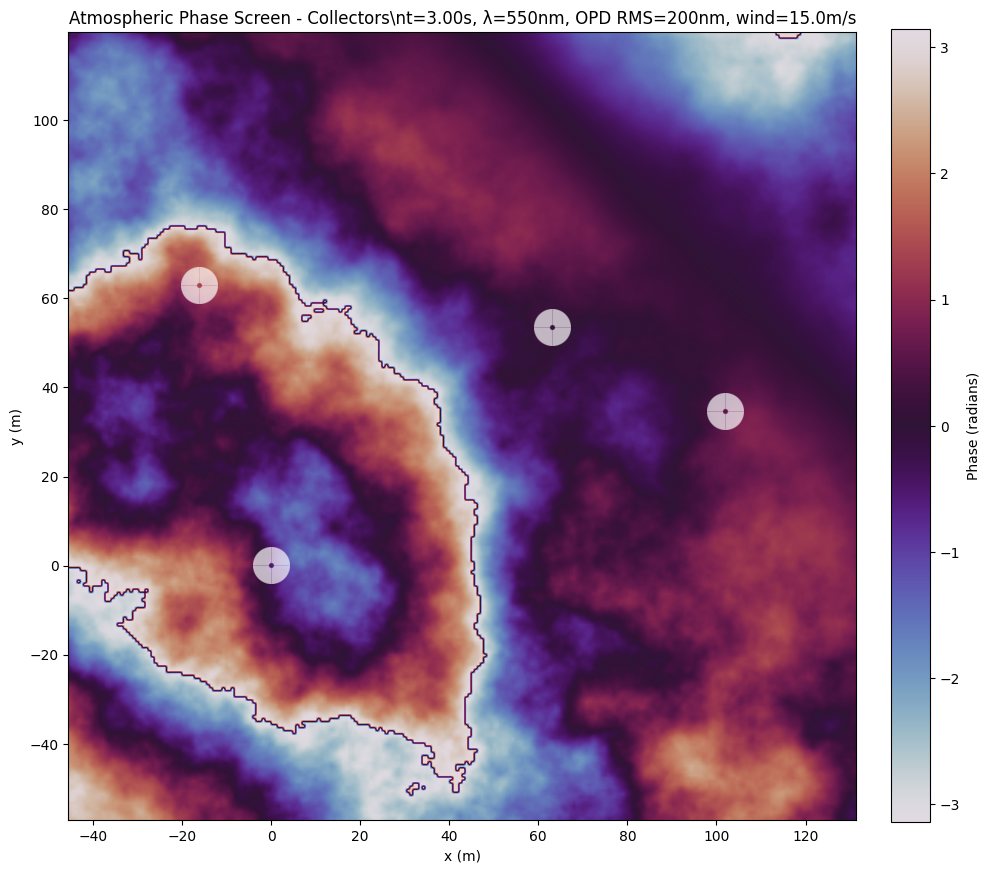

In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
from IPython.display import HTML

# Create VLTI if not already defined
if 'vlti' not in dir():
    vlti = helios.TelescopeArray.vlti(uts=True)

# Create animation showing interferometer array under atmospheric turbulence
atm_vlti = helios.Atmosphere(rms=200*u.nm, wind_speed=15*u.m/u.s, wind_direction=45, seed=789)

anim_interferometer = atm_vlti.plot_animation(
    collectors=vlti,
    duration=3*u.s,
    wavelength=550e-9*u.m,
    npix=256,
    fps=10,
    figsize=(10, 10)
)

# Display the animation
HTML(anim_interferometer.to_jshtml())


## 4. Coronagraphic Phase Masks
Coronagraphs use phase masks to suppress starlight and enhance the detection of faint companions. HELIOS supports vortex and 4-quadrant phase masks.

### Visualize Phase Masks
Phase masks modulate the wavefront in the focal plane to suppress on-axis light.

Star flux at 550nm: 4416055324237048.5 W / (sr m3)
Planet flux at 550nm: 302565795.02693284 W / (sr m3)
Planet/Star contrast at 550nm: 6.9e-08


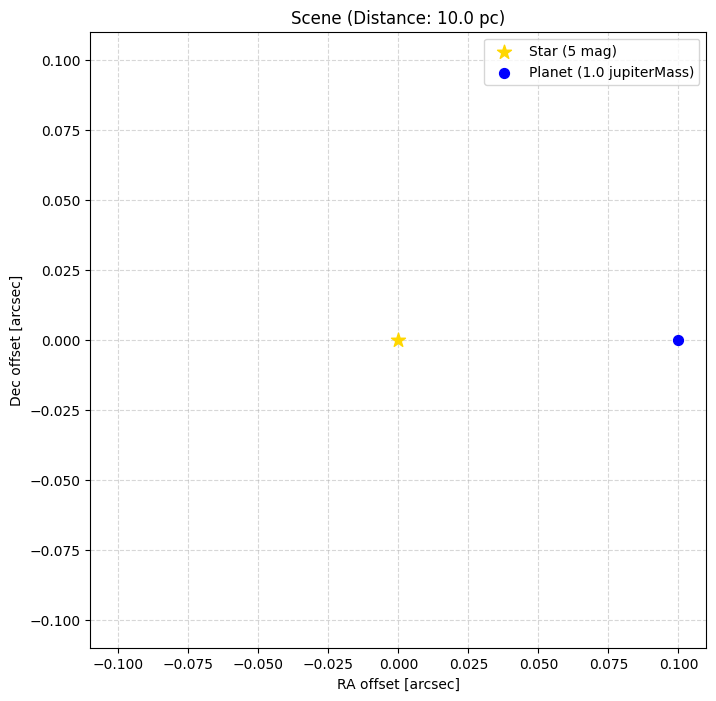


Planet position: (213, 128) pixels
Pixel scale: 0.0012 arcsec/pixel
✓ Planète boostée artificiellement d'un facteur 1.0e+05 pour visualisation coronographique


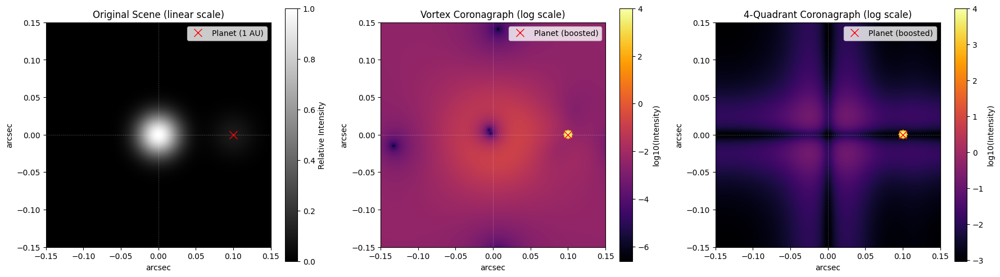


Scene dynamic range: 2.7e+24
Vortex suppression at center: 2.7e+03x
Peak intensity at planet location (vortex): 5.19e-03


In [17]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt
import numpy as np

scene = helios.Scene(distance=10*u.pc)
star = helios.Star(temperature=5700*u.K, magnitude=5, mass=1*u.M_sun, position=(0*u.AU, 0*u.AU))
planet = helios.Planet(mass=1*u.M_jup, position=(1*u.AU, 0*u.AU))
scene.add(star)
scene.add(planet)

print(f"Star flux at 550nm: {star.flux_at(550e-9 * u.m)}")
print(f"Planet flux at 550nm: {planet.flux_at(550e-9 * u.m)}")
print(f"Planet/Star contrast at 550nm: {planet.flux_at(550e-9 * u.m)/star.flux_at(550e-9 * u.m):.1e}")
scene.plot()
plt.show()

# Physical parameters
lam = 550e-9 * u.m
D = 6.5 * u.m
fov = 0.3 * u.arcsec  # Larger FOV to see planet at 0.1 arcsec

# Create coronagraph instances
coro_vortex = helios.Coronagraph(phase_mask='vortex')
coro_4q = helios.Coronagraph(phase_mask='4quadrants')

# Render the scene to an image
scene_img, x, y = scene.render(npix=256, fov=fov, return_coords=True)
extent = [x[0].value, x[-1].value, y[0].value, y[-1].value]

# Apply coronagraphs WITHOUT normalization to preserve flux distribution
img_vortex = coro_vortex.image_from_scene(scene_img, soft=True, oversample=4, 
                                          normalize=False, lam=lam, diameter=D, fov=fov)
img_4q = coro_4q.image_from_scene(scene_img, soft=True, oversample=4, 
                                  normalize=False, lam=lam, diameter=D, fov=fov)

# Find planet position in pixels (1 AU at 10 pc = 0.1 arcsec)
planet_angle = 0.1  # arcsec
pixel_scale = fov.to(u.arcsec).value / 256
planet_idx_x = int(256/2 + planet_angle / pixel_scale)
planet_idx_y = 256//2

print(f"\nPlanet position: ({planet_idx_x}, {planet_idx_y}) pixels")
print(f"Pixel scale: {pixel_scale:.4f} arcsec/pixel")

# Boost planet ONLY in coronagraph images for visualization
boost_factor = 1e5
radius_px = 5
sigma = 2.0

# Create boosted versions for coronagraph panels
img_vortex_boosted = img_vortex.copy()
img_4q_boosted = img_4q.copy()

for dy in range(-radius_px, radius_px+1):
    for dx in range(-radius_px, radius_px+1):
        yy = planet_idx_y + dy
        xx = planet_idx_x + dx
        if 0 <= yy < 256 and 0 <= xx < 256:
            r2 = dx**2 + dy**2
            if r2 <= radius_px**2:
                gaussian_weight = np.exp(-r2 / (2*sigma**2))
                # Boost only coronagraph images
                img_vortex_boosted[yy, xx] += boost_factor * gaussian_weight * scene_img[planet_idx_y, planet_idx_x]
                img_4q_boosted[yy, xx] += boost_factor * gaussian_weight * scene_img[planet_idx_y, planet_idx_x]

print(f"✓ Planète boostée artificiellement d'un facteur {boost_factor:.1e} pour visualisation coronographique")

# Display comparison with logarithmic scale
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Original scene (linear scale, no boost)
vmin_scene = 0
vmax_scene = scene_img.max()
im0 = axes[0].imshow(scene_img, origin='lower', cmap='gray', extent=extent,
                     vmin=vmin_scene, vmax=vmax_scene)
axes[0].set_title('Original Scene (linear scale)')
axes[0].set_xlabel('arcsec')
axes[0].set_ylabel('arcsec')
axes[0].plot([planet_angle], [0], 'rx', markersize=10, label='Planet (1 AU)')
plt.colorbar(im0, ax=axes[0], label='Relative Intensity')
axes[0].legend()

# Vortex coronagraph (log scale, with boost)
img_vortex_display = np.log10(img_vortex_boosted + 1e-10)
im1 = axes[1].imshow(img_vortex_display, origin='lower', cmap='inferno', extent=extent)
axes[1].set_title('Vortex Coronagraph (log scale)')
axes[1].set_xlabel('arcsec')
axes[1].set_ylabel('arcsec')
axes[1].plot([planet_angle], [0], 'rx', markersize=10, label='Planet (boosted)')
plt.colorbar(im1, ax=axes[1], label='log10(Intensity)')
axes[1].legend()

# 4-Quadrant coronagraph (log scale, with boost)
img_4q_display = np.log10(img_4q_boosted + 1e-10)
im2 = axes[2].imshow(img_4q_display, origin='lower', cmap='inferno', extent=extent)
axes[2].set_title('4-Quadrant Coronagraph (log scale)')
axes[2].set_xlabel('arcsec')
axes[2].set_ylabel('arcsec')
axes[2].plot([planet_angle], [0], 'rx', markersize=10, label='Planet (boosted)')
plt.colorbar(im2, ax=axes[2], label='log10(Intensity)')
axes[2].legend()

for ax in axes:
    ax.axvline(0, color='white', ls='--', alpha=0.3, lw=0.5)
    ax.axhline(0, color='white', ls='--', alpha=0.3, lw=0.5)

plt.tight_layout()
plt.show()

# Diagnostics
print(f"\nScene dynamic range: {scene_img.max()/scene_img.min():.1e}")
print(f"Vortex suppression at center: {scene_img.max()/img_vortex[128,128]:.1e}x")
print(f"Peak intensity at planet location (vortex): {img_vortex[planet_idx_y, planet_idx_x]:.2e}")


### Coronagraphic Imaging
Apply coronagraphic masks to the rendered scene to suppress starlight and reveal the planet.

Star flux at 550nm: 4416055324237048.5 W / (sr m3)
Planet flux at 550nm: 87774125.97688654 W / (sr m3)
Planet/Star contrast at 550nm: 2.0e-08


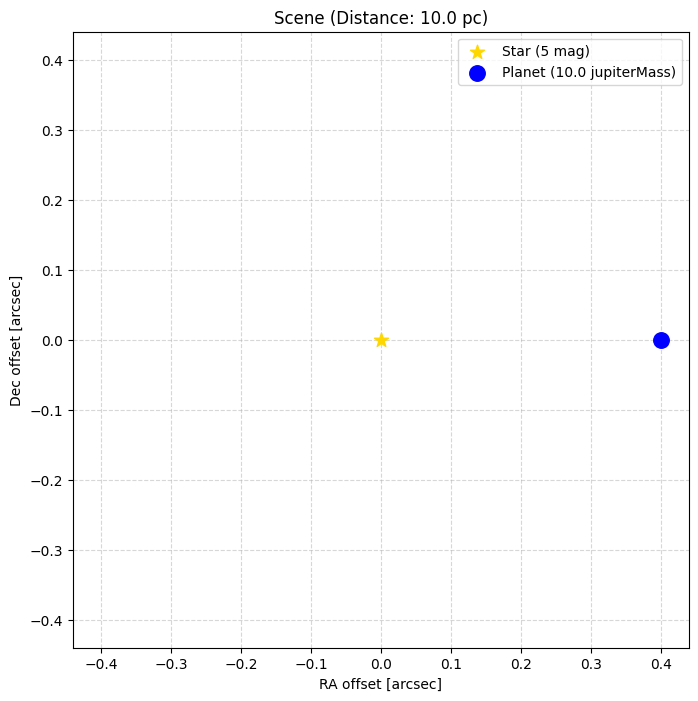


--- Coronagraph Performance ---
Vortex suppression: 9.2e+00x
4-Quadrant suppression: 7.0e+00x

--- Planet Detection ---
Planet position: (230, 128) pixels = 0.4 arcsec
Original scene at planet: 1.00e-01
Vortex image at planet: 9.83e-06
4-Quadrant at planet: 3.14e-05
⚠️ La planète n'est PAS visible après coronagraphe car elle est trop proche du centre
   (le coronagraphe supprime TOUT dans un rayon ~2 λ/D, incluant la planète)


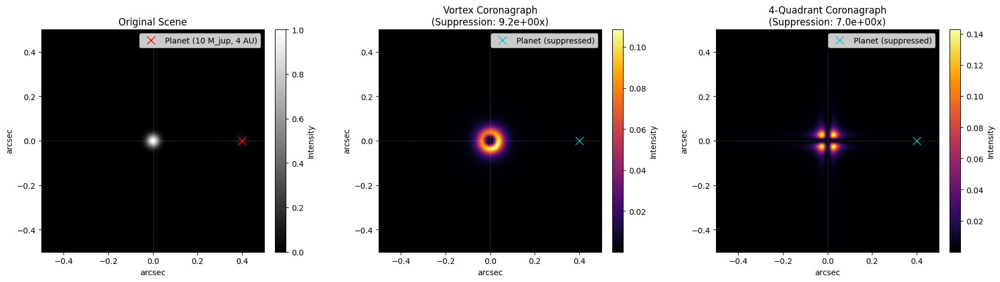


Scene dynamic range: 2.7e+271
Angle correspondant à 2 λ/D pour D=6.5m à 550.0nm: 0.035 arcsec


In [18]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u
import matplotlib.pyplot as plt
import numpy as np

scene = helios.Scene(distance=10*u.pc)
star = helios.Star(temperature=5700*u.K, magnitude=5, mass=1*u.M_sun, position=(0*u.AU, 0*u.AU))
planet = helios.Planet(mass=10*u.M_jup, position=(4*u.AU, 0*u.AU))
scene.add(star)
scene.add(planet)

print(f"Star flux at 550nm: {star.flux_at(550e-9 * u.m)}")
print(f"Planet flux at 550nm: {planet.flux_at(550e-9 * u.m)}")
print(f"Planet/Star contrast at 550nm: {planet.flux_at(550e-9 * u.m)/star.flux_at(550e-9 * u.m):.1e}")
scene.plot()
plt.show()

# Physical parameters
lam = 550e-9 * u.m
D = 6.5 * u.m
fov = 1 * u.arcsec

# Create coronagraph instances
coro_vortex = helios.Coronagraph(phase_mask='vortex')
coro_4q = helios.Coronagraph(phase_mask='4quadrants')

# Render the scene to an image
scene_img, x, y = scene.render(npix=256, fov=fov, return_coords=True)
extent = [x[0].value, x[-1].value, y[0].value, y[-1].value]

# Apply coronagraphs WITHOUT normalization to preserve physical flux distribution
img_vortex = coro_vortex.image_from_scene(scene_img, soft=True, oversample=4, 
                                          normalize=False, lam=lam, diameter=D, fov=fov)
img_4q = coro_4q.image_from_scene(scene_img, soft=True, oversample=4, 
                                  normalize=False, lam=lam, diameter=D, fov=fov)

# Calculate suppression ratios
max_before = scene_img.max()
max_after_vortex = img_vortex.max()
max_after_4q = img_4q.max()
suppression_vortex = max_before / max_after_vortex
suppression_4q = max_before / max_after_4q

print(f"\n--- Coronagraph Performance ---")
print(f"Vortex suppression: {suppression_vortex:.1e}x")
print(f"4-Quadrant suppression: {suppression_4q:.1e}x")

# Find planet position (4 AU at 10 pc = 0.4 arcsec)
planet_angle = 0.4  # arcsec
pixel_scale = fov.to(u.arcsec).value / 256
planet_idx_x = int(256/2 + planet_angle / pixel_scale)
planet_idx_y = 256//2

print(f"\n--- Planet Detection ---")
print(f"Planet position: ({planet_idx_x}, {planet_idx_y}) pixels = {planet_angle} arcsec")
print(f"Original scene at planet: {scene_img[planet_idx_y, planet_idx_x]:.2e}")
print(f"Vortex image at planet: {img_vortex[planet_idx_y, planet_idx_x]:.2e}")
print(f"4-Quadrant at planet: {img_4q[planet_idx_y, planet_idx_x]:.2e}")
print(f"⚠️ La planète n'est PAS visible après coronagraphe car elle est trop proche du centre")
print(f"   (le coronagraphe supprime TOUT dans un rayon ~2 λ/D, incluant la planète)")

# Display comparison
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Original scene
im0 = axes[0].imshow(scene_img, origin='lower', cmap='gray', extent=extent)
axes[0].set_title('Original Scene')
axes[0].set_xlabel('arcsec')
axes[0].set_ylabel('arcsec')
axes[0].plot([planet_angle], [0], 'rx', markersize=10, label=f'Planet ({planet.mass.value:.0f} M_jup, 4 AU)')
cbar0 = plt.colorbar(im0, ax=axes[0], label='Intensity', fraction=0.046, pad=0.04)
axes[0].legend(loc='upper right')

# Vortex coronagraph
im1 = axes[1].imshow(img_vortex, origin='lower', cmap='inferno', extent=extent)
axes[1].set_title(f'Vortex Coronagraph\n(Suppression: {suppression_vortex:.1e}x)')
axes[1].set_xlabel('arcsec')
axes[1].set_ylabel('arcsec')
axes[1].plot([planet_angle], [0], 'cx', markersize=10, label='Planet (suppressed)')
cbar1 = plt.colorbar(im1, ax=axes[1], label='Intensity', fraction=0.046, pad=0.04)
axes[1].legend(loc='upper right')

# 4-Quadrant coronagraph
im2 = axes[2].imshow(img_4q, origin='lower', cmap='inferno', extent=extent)
axes[2].set_title(f'4-Quadrant Coronagraph\n(Suppression: {suppression_4q:.1e}x)')
axes[2].set_xlabel('arcsec')
axes[2].set_ylabel('arcsec')
axes[2].plot([planet_angle], [0], 'cx', markersize=10, label='Planet (suppressed)')
cbar2 = plt.colorbar(im2, ax=axes[2], label='Intensity', fraction=0.046, pad=0.04)
axes[2].legend(loc='upper right')

for ax in axes:
    ax.axvline(0, color='white', ls='--', alpha=0.3, lw=0.5)
    ax.axhline(0, color='white', ls='--', alpha=0.3, lw=0.5)

plt.tight_layout()
plt.show()

print(f"\nScene dynamic range: {scene_img.max()/scene_img.min():.1e}")

# Affiche l'angle correspondant à 2 λ/D pour D=6.5m à 550nm
theta_lambda_D = (2 * lam / D * u.rad).to(u.arcsec)
print(f"Angle correspondant à 2 λ/D pour D={D.value}m à {lam.to(u.nm).value}nm: {theta_lambda_D:.3f}")

## 5. Advanced: Atmospheric Degradation

**Chromatic PSF degradation**

The atmosphere degrades the PSF through chromatic phase aberrations. We compare PSFs at different wavelengths and atmospheric conditions to visualize the chromatic nature of seeing.

All PSFs are normalized to the ideal (no-atmosphere) peak to visualize Strehl ratio: Strehl = peak_degraded / peak_ideal.

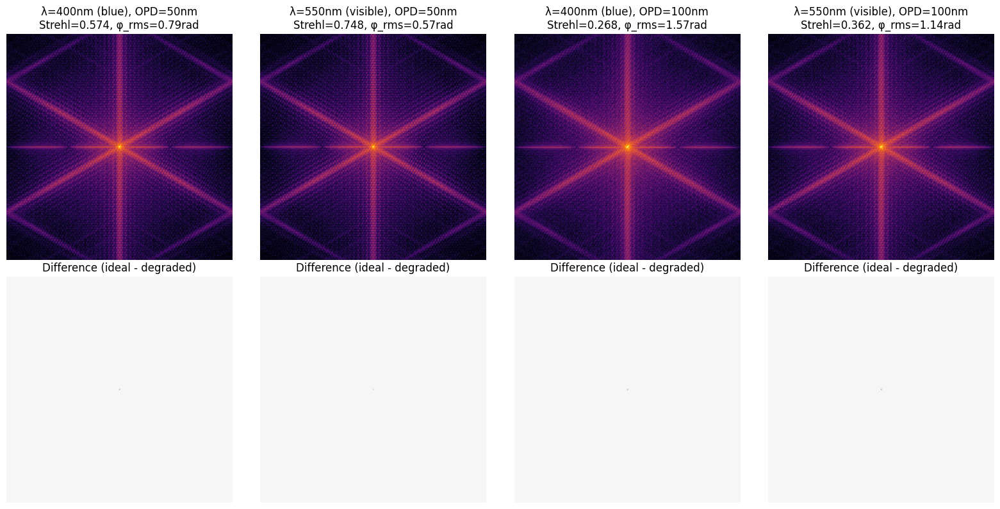

Note: Shorter wavelengths (blue) show more phase aberration for same OPD


In [13]:
# Atmospheric degradation: compare different wavelengths and seeing conditions
import helios
import numpy as np
from astropy import units as u
import matplotlib.pyplot as plt

# Array size
N = 512

# Build pupil amplitude (JWST-like)
pupil = helios.Pupil.like('JWST')
p_amp = pupil.get_array(npix=N, soft=True)

# Test cases: (wavelength_nm, atm_opd_nm, subplot_title)
test_cases = [
    (400, 50, "λ=400nm (blue), OPD=50nm"),
    (550, 50, "λ=550nm (visible), OPD=50nm"),
    (400, 100, "λ=400nm (blue), OPD=100nm"),
    (550, 100, "λ=550nm (visible), OPD=100nm"),
]

fig, axes = plt.subplots(2, 4, figsize=(16, 8))
axes = axes.flatten()

for i, (wl_nm, opd_nm, title) in enumerate(test_cases):
    wavelength = wl_nm * 1e-9 * u.m
    
    # Compute ideal (no-atmosphere) PSF for this wavelength
    wf_ideal = helios.Wavefront(wavelength=wavelength, size=N)
    wf_ideal.field = p_amp.astype(np.complex128)
    field_ideal = np.fft.fftshift(np.fft.fft2(np.fft.ifftshift(wf_ideal.field)))
    psf_ideal = np.abs(field_ideal) ** 2
    peak_ideal = psf_ideal.max()
    
    # Create wavefront with atmosphere
    wf = helios.Wavefront(wavelength=wavelength, size=N)
    wf.field = p_amp.astype(np.complex128)
    
    # Apply atmosphere
    atm = helios.Atmosphere(rms=opd_nm * u.nm, seed=42)
    wf_atm = atm.process(wf)
    
    # Compute degraded PSF
    field_final = np.fft.fftshift(np.fft.fft2(np.fft.ifftshift(wf_atm.field)))
    psf_final = np.abs(field_final) ** 2
    
    # Normalize all PSFs to ideal peak
    psf_norm_ideal = psf_ideal / peak_ideal
    psf_norm_final = psf_final / peak_ideal
    
    # Compute Strehl (peak ratio)
    strehl = psf_final.max() / peak_ideal
    
    # Expected phase RMS in radians
    phase_rms_rad = 2 * np.pi * (opd_nm * 1e-9) / (wl_nm * 1e-9)
    
    # Difference map
    diff = psf_norm_ideal - psf_norm_final
    
    # Plot degraded PSF
    axes[i].imshow(np.log10(psf_norm_final + 1e-10), origin='lower', cmap='inferno')
    axes[i].set_title(f"{title}\nStrehl={strehl:.3f}, φ_rms={phase_rms_rad:.2f}rad")
    axes[i].axis('off')
    
    # Plot difference in the second row
    axes[i+4].imshow(diff, origin='lower', cmap='RdBu_r', vmin=-0.5, vmax=0.5)
    axes[i+4].set_title("Difference (ideal - degraded)")
    axes[i+4].axis('off')

plt.tight_layout()
plt.show()

print("Note: Shorter wavelengths (blue) show more phase aberration for same OPD")

## 6. Full End-to-End Simulation
Putting it all together: Scene → Collectors → Camera.

Simulation complete!
Result shape: (256, 256)
Result range: [0.00e+00, 0.00e+00]


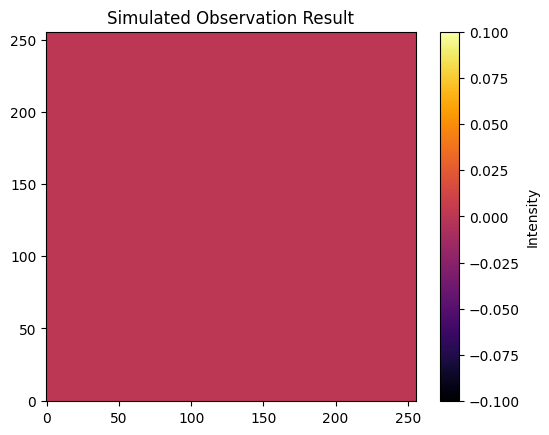

In [ ]:
import sys
sys.path.insert(0, './src')
import helios
from astropy import units as u

# Create scene if not already defined
if 'scene' not in dir():
    scene = helios.Scene(distance=10*u.pc)
    star = helios.Star(temperature=5700*u.K, magnitude=5, mass=1*u.M_sun, position=(0*u.AU, 0*u.AU))
    planet = helios.Planet(mass=1*u.M_jup, position=(1*u.AU, 0*u.AU))
    scene.add(star)
    scene.add(planet)

# Build a complete observation pipeline
collectors = helios.TelescopeArray(latitude=0*u.deg, longitude=0*u.deg, altitude=2400*u.m)
pupil_obs = helios.Pupil(8*u.m)
collectors.add_collector(pupil=pupil_obs, position=(0, 0), size=8*u.m)

camera = helios.Camera(pixels=(256, 256))

# Create context and add layers
context = helios.Context()
context.add_layer(scene)
context.add_layer(collectors)
context.add_layer(camera)

# Run the simulation
result = context.observe()
print(f"Simulation complete!")
print(f"Result shape: {result.shape}")
print(f"Result range: [{result.min():.2e}, {result.max():.2e}]")
import matplotlib.pyplot as plt
plt.imshow(result, origin='lower', cmap='inferno')
plt.colorbar(label='Intensity')
plt.title('Simulated Observation Result')
plt.show()


## 7. UML Diagram Visualization

HELIOS can automatically generate UML-style diagrams to visualize your complete optical setup from scene to detector. This is useful for:
- Documenting complex optical systems
- Verifying pipeline structure before simulation
- Communicating system designs

### Simple Pipeline Diagram

Create a simple optical system and visualize it as a diagram.

Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.


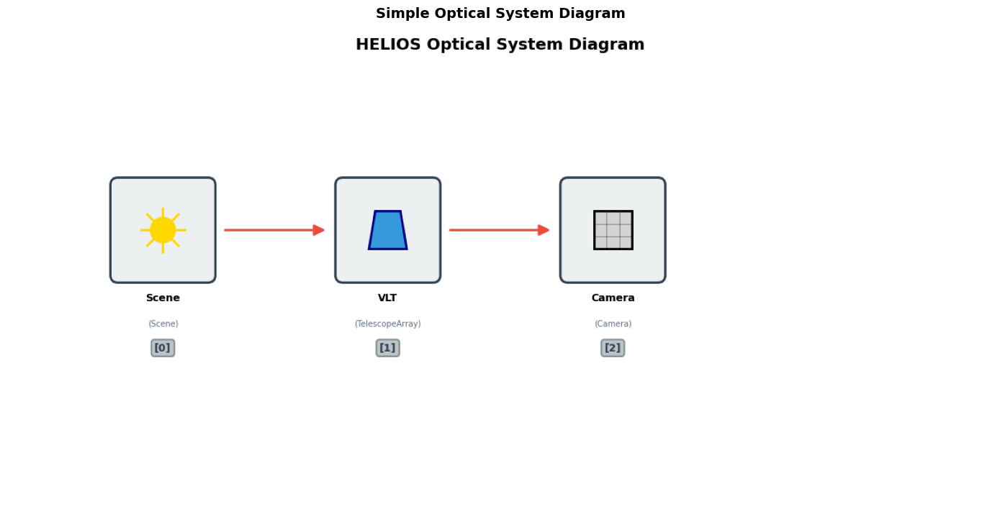

Diagram shape: (600, 1200, 3)
✓ Simple pipeline: Scene → Telescope → Camera


In [2]:
import helios
from astropy import units as u
import matplotlib.pyplot as plt
import numpy as np

# Simple pipeline: Scene → Telescope → Camera
simple_scene = helios.Scene(distance=10*u.pc)
simple_scene.add(helios.Star(temperature=5700*u.K, magnitude=5))

simple_telescope = helios.TelescopeArray(name="VLT")
simple_telescope.add_collector(pupil=helios.Pupil.vlt(), position=(0, 0), size=8*u.m)

simple_camera = helios.Camera(pixels=(512, 512))

simple_ctx = helios.Context()
simple_ctx.add_layer(simple_scene)
simple_ctx.add_layer(simple_telescope)
simple_ctx.add_layer(simple_camera)

# Generate diagram as image array (exported directly as numpy array)
diagram_img = simple_ctx.plot_uml_diagram(return_type='image')

# Display the diagram
plt.figure(figsize=(14, 8))
plt.imshow(diagram_img)
plt.axis('off')
plt.title('Simple Optical System Diagram', fontsize=14, fontweight='bold', pad=15)
plt.tight_layout()
plt.show()

print(f"Diagram shape: {diagram_img.shape}")
print("✓ Simple pipeline: Scene → Telescope → Camera")

### Dual-Channel System with Beam Splitter

When a beam splitter creates parallel paths, they are displayed vertically in the diagram.

Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.


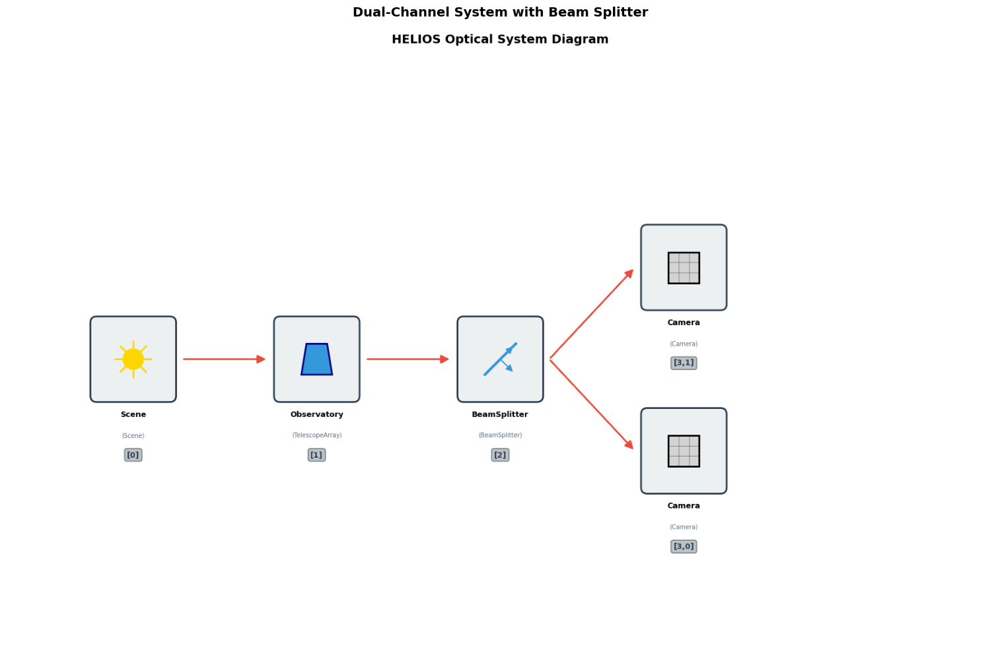

✓ Parallel paths displayed vertically after beam splitter


In [3]:
# Dual-channel system with beam splitter
dual_scene = helios.Scene(distance=10*u.pc)
dual_scene.add(helios.Star(temperature=5700*u.K, magnitude=5))

dual_telescope = helios.TelescopeArray(name="Observatory")
dual_telescope.add_collector(pupil=helios.Pupil.vlt(), position=(0, 0), size=8*u.m)

# Beam splitter
bs = helios.BeamSplitter(cutoff=0.5)

# Two cameras on parallel paths
camera1 = helios.Camera(pixels=(512, 512))
camera2 = helios.Camera(pixels=(256, 256))

# Build context
dual_ctx = helios.Context()
dual_ctx.add_layer(dual_scene)
dual_ctx.add_layer(dual_telescope)
dual_ctx.add_layer(bs)
dual_ctx.add_layer([camera1, camera2])  # Parallel paths

# Generate diagram as image
dual_diagram_img = dual_ctx.plot_uml_diagram(return_type='image', figsize=(16, 10))

# Display
plt.figure(figsize=(16, 10))
plt.imshow(dual_diagram_img)
plt.axis('off')
plt.title('Dual-Channel System with Beam Splitter', fontsize=14, fontweight='bold', pad=15)
plt.tight_layout()
plt.show()

print("✓ Parallel paths displayed vertically after beam splitter")

### Complex Exoplanet Detection System

A complete high-contrast imaging system with atmosphere, adaptive optics, and coronagraph.

Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.


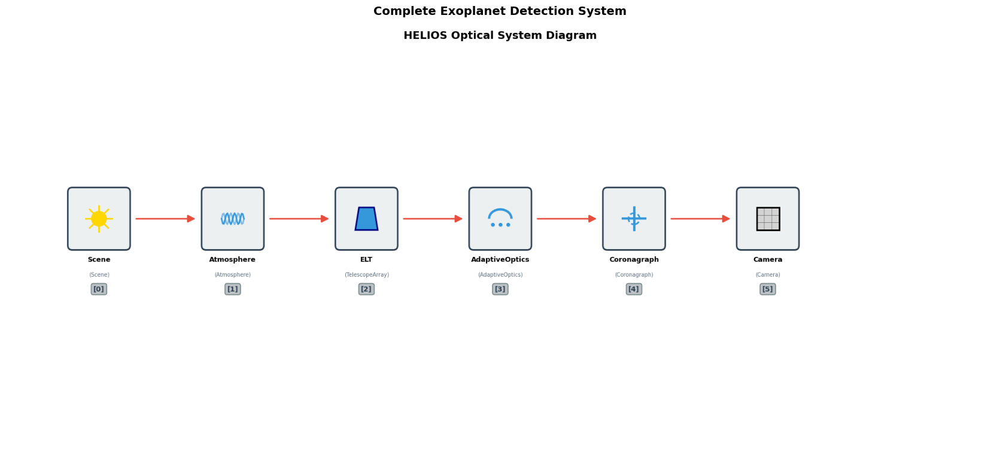

✓ Complete pipeline: Scene → Atmosphere → Telescope → AO → Coronagraph → Camera


In [4]:
# Complete exoplanet detection system
exo_scene = helios.Scene(distance=10*u.pc)
exo_scene.add(helios.Star(temperature=5700*u.K, magnitude=5, position=(0, 0)))
exo_scene.add(helios.Planet(temperature=300*u.K, magnitude=22, position=(100*u.mas, 0*u.mas)))

# Atmospheric turbulence
atmosphere = helios.Atmosphere(rms=200*u.nm, wind_speed=8*u.m/u.s, seed=42)

# Large telescope (ELT)
elt = helios.TelescopeArray(name="ELT")
elt.add_collector(pupil=helios.Pupil.elt(), position=(0, 0), size=39*u.m)

# Adaptive optics correction
ao = helios.AdaptiveOptics(coeffs={(1, 1): 0.15, (2, 0): 0.08})

# Coronagraph for high contrast
coronagraph = helios.Coronagraph(phase_mask='4quadrants')

# Science camera
exo_camera = helios.Camera(pixels=(1024, 1024))

# Build pipeline
exo_ctx = helios.Context()
exo_ctx.add_layer(exo_scene)
exo_ctx.add_layer(atmosphere)
exo_ctx.add_layer(elt)
exo_ctx.add_layer(ao)
exo_ctx.add_layer(coronagraph)
exo_ctx.add_layer(exo_camera)

# Generate diagram as image
exo_diagram_img = exo_ctx.plot_uml_diagram(return_type='image', figsize=(18, 8))

# Display
plt.figure(figsize=(18, 8))
plt.imshow(exo_diagram_img)
plt.axis('off')
plt.title('Complete Exoplanet Detection System', fontsize=14, fontweight='bold', pad=15)
plt.tight_layout()
plt.show()

print("✓ Complete pipeline: Scene → Atmosphere → Telescope → AO → Coronagraph → Camera")

### Export Options

You can export diagrams in three ways:
- `return_type='figure'`: Returns matplotlib Figure object (default)
- `return_type='image'`: Returns numpy array (RGB image, used above)
- `return_type='both'`: Returns tuple (figure, image_array)

You can also save directly to file:

Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.


✓ Diagram saved to my_optical_system.png


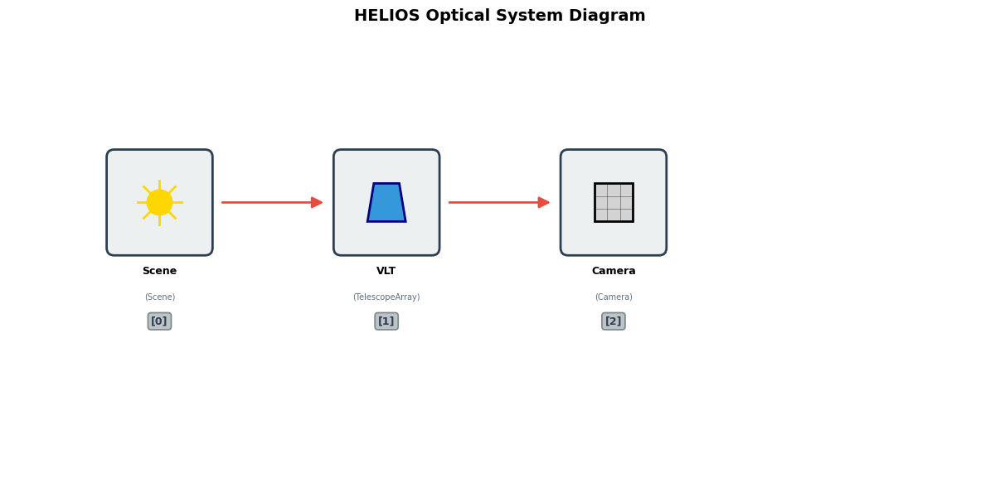

Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.


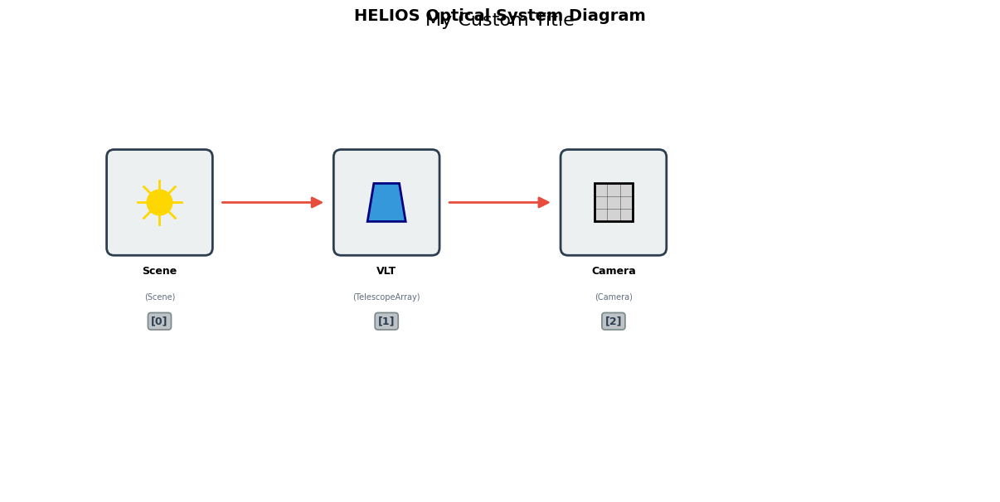

Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed y limits to fulfill fixed data aspect with adjustable data limits.


Figure: Figure(1200x600)
Image array shape: (600, 1200, 3), dtype: uint8


In [5]:
# Example: Save diagram directly to file
simple_ctx.plot_uml_diagram(save_path='my_optical_system.png')
print("✓ Diagram saved to my_optical_system.png")

# Example: Get matplotlib figure for customization
fig = simple_ctx.plot_uml_diagram(return_type='figure')
fig.suptitle('My Custom Title', fontsize=16, y=0.98)
plt.show()
plt.close(fig)

# Example: Get both figure and image array
fig, img = simple_ctx.plot_uml_diagram(return_type='both')
print(f"Figure: {fig}")
print(f"Image array shape: {img.shape}, dtype: {img.dtype}")
plt.close(fig)